# Multi-scale modeling

[Tutorial 1.3](../1.%20compartmental%20models/1.3%20Generation.ipynb) covered how to generate biphysically detailed compartmental models of a neuron. [Tutorial 2.1](../2.%20network%20models/2.1%20Anatomical%20embedding.ipynb) and [Tutorial 2.2](../2.%20network%20models/2.2%20Synaptic%20activation.ipynb) covered how to embed neuron models into a network reconstruction, and how to generate synaptic activity that reflects an in-vivo condition.

This tutorial will show how to combine the two models into a single multi-scale simlation. It willl show how to adapt a neuron's synaptic properties, such that the cell exhibits neurobiologically consistent biphyscal properties given its intrinsic biphysical expression, and show how the spatiotemporal synaptic activity impinges onto the dendritic tree.

In [1]:
import Interface as I
from getting_started import getting_started_dir
db = I.DataBase('{}/labs/getting_started_db/'.format(I.os.environ['HOME']))

if not 'biophysical_constraints' in db.keys():
    cell_parameter_file = I.os.path.join(
        getting_started_dir, 
        'example_data',
        'biophysical_constraints', 
        '86_CDK_20041214_BAC_run5_soma_Hay2013_C2center_apic_rec.param')
    I.shutil.copy(cell_parameter_file, db.create_managed_folder('biophysical_constraints'))
cell_parameter_file = db['biophysical_constraints'].join('86_CDK_20041214_BAC_run5_soma_Hay2013_C2center_apic_rec.param')

[INFO] l5pt: Loading mechanisms:
[INFO] distributed_lock: trying to connect to distributed locking server {'config': {'hosts': 'somalogin02:33333'}, 'type': 'zookeeper'}
[INFO] distributed_lock: success!
[INFO] ISF: Current version: heads/dumper_meta+0.g532c62bc.dirty
[INFO] ISF: Current pid: 12911
[WARNING] warnings: /gpfs/soma_fs/scratch/meulemeester/isf_test/lib/python3.8/site-packages/pandas_msgpack-0.1.4+14.gfcb0471.dirty-py3.8-linux-x86_64.egg/pandas_msgpack/packers.py:78: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import (Timestamp, Period, Series, DataFrame,  # noqa

[WARNING] warnings: /gpfs/soma_fs/scratch/meulemeester/project_src/in_silico_framework/Interface.py:212: UserWarning:

The source folder has uncommited changes!


[WARNING] ISF: Could not load linked views



[INFO] ISF: Loaded modules with __version__ attribute are:
IPython: 7.19.0, Interface: heads/dumper_

## Simulating synaptic activity

This tutorial will simulate the in-vivo condition of deflecting a rat whisker. We simulate one single trail for each whisker stimulus and save the result in the database under the simrun key.

In [2]:
delayeds = []

# Delete previous results, if they exist
if 'simrun' in db.keys(): 
    del db['simrun']
    
# Create new folder for results
db.create_managed_folder('simrun')
for whisker in ['B1', 'B2', 'B3', 'C1', 'C2', 'C3', 'D1', 'D2', 'D3']:
    network_file = db['network_param'].join('{}_stim.param'.format(whisker))
    dir_prefix = db['simrun'].join('stim_{}'.format(whisker))
    
    nSweeps = 1 # number of consecutive simulations per process
    nprocs = 1 # number of processes simulating that task in parallel    
    tStop = 300 # stop the simulation at 300ms
    
    d = I.simrun_run_new_simulations(
        cell_parameter_file, # defined in the above cell
        network_file, 
        dirPrefix = dir_prefix,
        nSweeps = nSweeps, 
        nprocs = nprocs, 
        tStop = tStop, 
        silent = False)
    delayeds.append(d)

[WARNING] isf_data_base: The database source folder has uncommitted changes!


`I.simrun_run_new_simulations` returns [`dask.delayed`](https://docs.dask.org/en/latest/delayed.html) objects, i.e. they result describes *how* the computation can be run, but it is not computed yet. We send it to our local cluster:

In [3]:
client = I.get_client()
client

Client Scheduler: tcp://10.100.2.218:38786 Dashboard: http://10.100.2.218:38787/status,Cluster Workers: 40 Cores: 40 Memory: 4.00 TB


In [4]:
futures = client.compute(delayeds)

The computation happens in the background and does not block the Python kernel. We can visualize the progress:

In [5]:
I.distributed.progress(futures)

VBox()

Now, the "simrun" folder in the DataBase contains the simulation results

In [8]:
db['simrun'].listdir()

['Loader.json',
 'stim_C1',
 'stim_B2',
 'stim_D3',
 'stim_D1',
 'stim_B3',
 'stim_B1',
 'stim_D2',
 'stim_C3',
 'metadata.json',
 'stim_C2']

## Analyzing the results

This tutorial will show how to use the [DataBase](../../../data_base/__init__.py) package to efficiently analyze simulations of synaptic activations onto a network-embedded biphysically detailed neuron model.

In [9]:
I.db_init_simrun_general.init(
    db,
    db['simrun'],
    client=client
)

[WARNING] isf_data_base: The database source folder has uncommitted changes!
[WARNING] isf_data_base: The database source folder has uncommitted changes!
[WARNING] isf_data_base: The database source folder has uncommitted changes!
[WARNING] isf_data_base: The database source folder has uncommitted changes!
[WARNING] isf_data_base: The database source folder has uncommitted changes!
[WARNING] isf_data_base: The database source folder has uncommitted changes!
[WARNING] isf_data_base: The database source folder has uncommitted changes!
[WARNING] isf_data_base: The database source folder has uncommitted changes!
[WARNING] isf_data_base: The database source folder has uncommitted changes!
[WARNING] isf_data_base: The database source folder has uncommitted changes!
[WARNING] isf_data_base: The database source folder has uncommitted changes!
[WARNING] isf_data_base: The database source folder has uncommitted changes!
[WARNING] isf_data_base: The database source folder has uncommitted changes!

We can initialize this simulation result database for convenient access to the data using the widely used pandas and dask libraries. It also converts the data to an optimized binary format (parquet, also the synapse and cell activation data is categorized, i.e. repeated values are replaced by an integer). This gives the following advantages:
  - reduced space on harddisk (25% of original data)
  - fast access

Now, the following keys are set:

| Key | Description | Type |
|---|---|---|
| `synapse_activation` |activation of synapses for each simulationtrail | `dask.DataFrame` |
|`cell_activation`| activation of presynaptic cells for each simulationtrail| `dask.DataFrame`
|`voltage_traces`| soma voltage traces| `dask.DataFrame`
|`spike_times`| spike times| `pandas.DataFrame`
|`dendritic_recordings`| voltage traces on the dendrite as specified in the cell parameter file| `DataBase` containing a separate `dask.DataFrame` for every recording location
|`metadata`| original filenames| `pandas.DataFrame`
|`parameterfiles`| mapping between simulation trial and used parameter files| `pandas.DataFrame`
|`parameterfiles_cell_folder`| folder containing the cell parameter files| `ManagedFolder`
|`parameterfiles_network_folder`| folder containing the network parameterfiles| `ManagedFolder`
|`sim_trail_index`| all simulation trials| `pandas.Series`
|`simresult_path`| original path from which the simulation has been loaded| `str`

Let's have a look at the synapse activation data frame:

In [10]:
db['synapse_activation']

load dask dataframe with known divisions


,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
npartitions=9,,,,,,,,,,,,,
stim_B1/results/20240510-1535_seed3435908655_pid12506/000000,object,int64,float64,int64,int64,object,float64,float64,float64,float64,float64,float64,float64
stim_B2/results/20240510-1535_seed1980434635_pid12481/000000,...,...,...,...,...,...,...,...,...,...,...,...,...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
stim_D3/results/20240510-1535_seed4030469498_pid12485/000000,...,...,...,...,...,...,...,...,...,...,...,...,...
stim_D3/results/20240510-1535_seed4030469498_pid12485/000000,...,...,...,...,...,...,...,...,...,...,...,...,...


This is a dask dataframe object. Instead of loading the data fully, it is a pointer to the actual data which is stored in the database using the parquet binary format. The data is split up into chunks of reasonable file size. 

Only when actual computations need to be done, are the values of the data loaded. Until then, it will only provide relevant metadata. Let's explicitly load a small fractin of the data to have a look:

In [11]:
head = db['synapse_activation'].head(2)
head

load dask dataframe with known divisions


,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
sim_trail_index,,,,,,,,,,,,,
stim_B1/results/20240510-1535_seed3435908655_pid12506/000000,L1_B2,8,1444.139328,73,13,ApicalDendrite,23.059317,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240510-1535_seed3435908655_pid12506/000000,L1_C1,1,1525.283134,49,64,ApicalDendrite,245.403658,NaN,NaN,NaN,NaN,NaN,NaN


We can select data using the index:

In [12]:
some_index = db['synapse_activation'].compute().index[0]
db['synapse_activation'].loc[some_index]

load dask dataframe with known divisions
load dask dataframe with known divisions


,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
npartitions=1,,,,,,,,,,,,,
stim_B1/results/20240510-1535_seed3435908655_pid12506/000000,object,int64,float64,int64,int64,object,float64,float64,float64,float64,float64,float64,float64
stim_B1/results/20240510-1535_seed3435908655_pid12506/000000,...,...,...,...,...,...,...,...,...,...,...,...,...


This returns a dask dataframe again; the query is not computed yet. To do this, call compute:

In [13]:
# this prints out a table containing all synapse activations during the specified trail
db['synapse_activation'].loc[some_index].compute()

load dask dataframe with known divisions


,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
sim_trail_index,,,,,,,,,,,,,
stim_B1/results/20240510-1535_seed3435908655_pid12506/000000,L1_B2,8,1444.139328,73,13,ApicalDendrite,23.059317,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240510-1535_seed3435908655_pid12506/000000,L1_C1,1,1525.283134,49,64,ApicalDendrite,245.403658,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240510-1535_seed3435908655_pid12506/000000,L1_C1,3,1439.699450,57,68,ApicalDendrite,245.403658,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240510-1535_seed3435908655_pid12506/000000,L1_C2,1,1416.085389,74,2,ApicalDendrite,250.671553,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240510-1535_seed3435908655_pid12506/000000,L1_C2,2,1360.903343,72,5,ApicalDendrite,250.671553,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
stim_B1/results/20240510-1535_seed3435908655_pid12506/000000,VPM_C1,17,246.381103,23,74,ApicalDendrite,261.116792,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240510-1535_seed3435908655_pid12506/000000,VPM_C1,20,106.440737,4,115,Dendrite,261.856516,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240510-1535_seed3435908655_pid12506/000000,VPM_C2,36,200.930665,20,46,ApicalDendrite,140.875162,NaN,NaN,NaN,NaN,NaN,NaN


What is the average distance of synapses from the soma by celltype?

In [14]:
# load dask dataframe
sa = db['synapse_activation']
# assign a new column: the celltype is the first part of the synapse_type column
sa['celltype'] = sa.map_partitions(lambda x: x.synapse_type.str.split('_').str[0])
# groupb by this value, compute the mean soma distance in each group, compute the result on the cluster
sa.groupby('celltype').apply(lambda x: x.soma_distance.mean()).compute(scheduler=client)

load dask dataframe with known divisions
[WARNING] warnings: <ipython-input-14-6f92211b20fc>:6: UserWarning:

`meta` is not specified, inferred from partial data. Please provide `meta` if the result is unexpected.
  Before: .apply(func)
  After:  .apply(func, meta={'x': 'f8', 'y': 'f8'}) for dataframe result
  or:     .apply(func, meta=('x', 'f8'))            for series result




celltype
L56Trans      166.447374
L1           1405.251910
L4py          278.546097
L6ct          169.037889
SymLocal1    1157.075535
SymLocal6     151.661303
L4sp          499.310383
L45Sym        197.277922
L5tt          232.976026
SymLocal4     123.738454
L23Trans      905.865248
L45Peak       352.327076
L4ss          412.998331
L2            763.633594
SymLocal3     220.411518
SymLocal5     155.003453
VPM           293.581162
L34           498.592163
L5st          781.816858
L6cc          319.259336
L6ccinv       234.165530
SymLocal2     705.683191
dtype: float64

### Visualizing the simulation

It is easy to create an animation of a simulation trail from the database:

In [15]:
cell = I.simrun_simtrial_to_cell_object(db, some_index)

[WARNING] client: Connection dropped: socket connection broken
[WARNING] client: Transition to CONNECTING


[WARNING] client: Session has expired



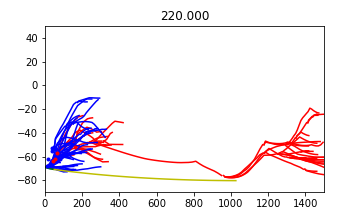
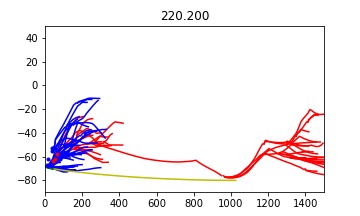
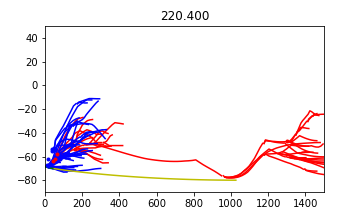
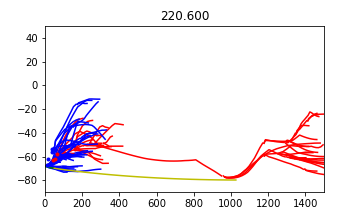
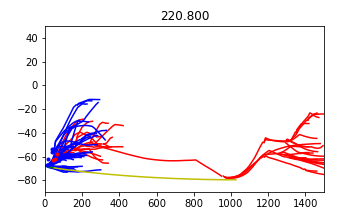
...
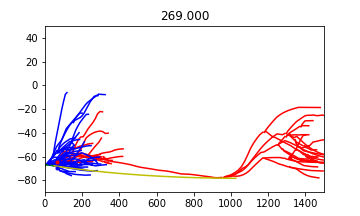
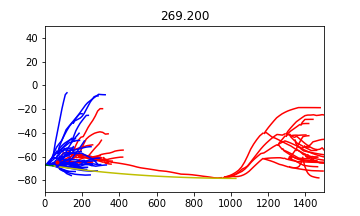
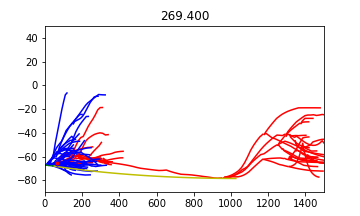
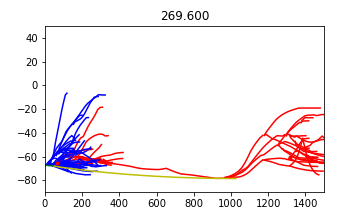
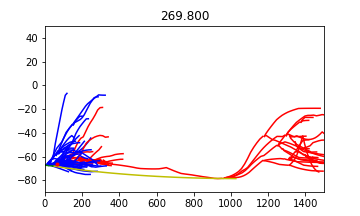

In [16]:
if not 'D3_stim_animation' in db.keys():
    I.cell_to_animation(
        cell,
        xlim = [0,1500],
        ylim = [-90, 50],
        tstart = 245-25,
        tend = 245+25,
        tstep = 0.2,
        outdir = db.create_managed_folder('D3_stim_animation'))
I.display_animation(db['D3_stim_animation'].join('*', '*png'), embedded = True)

Or to visualize the synapse activations on the postsynaptic cell.


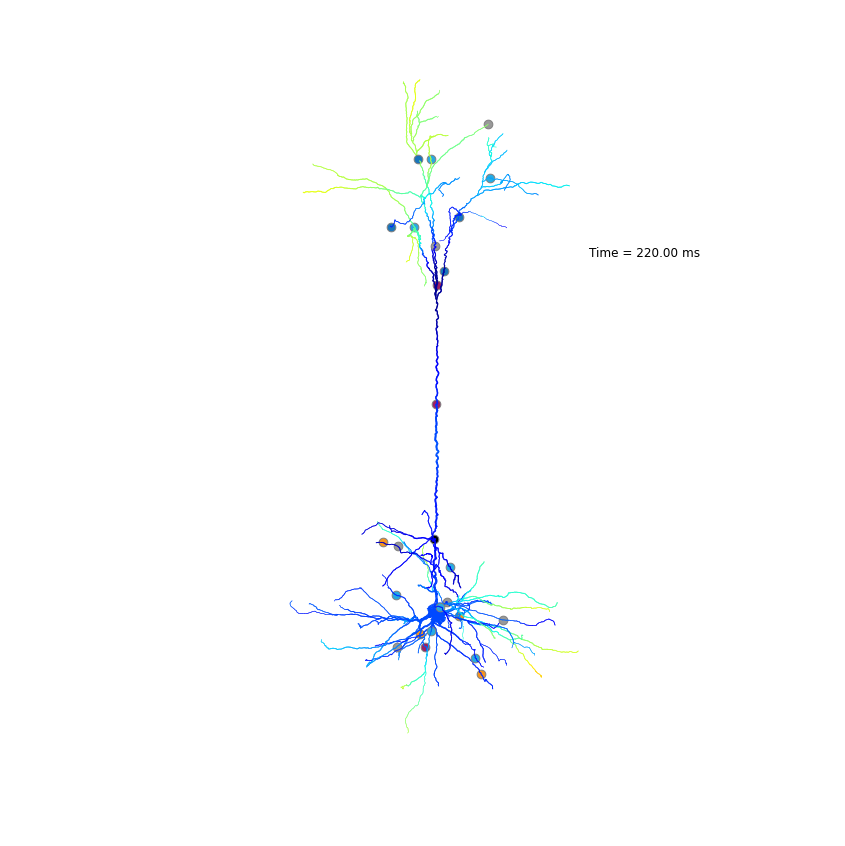
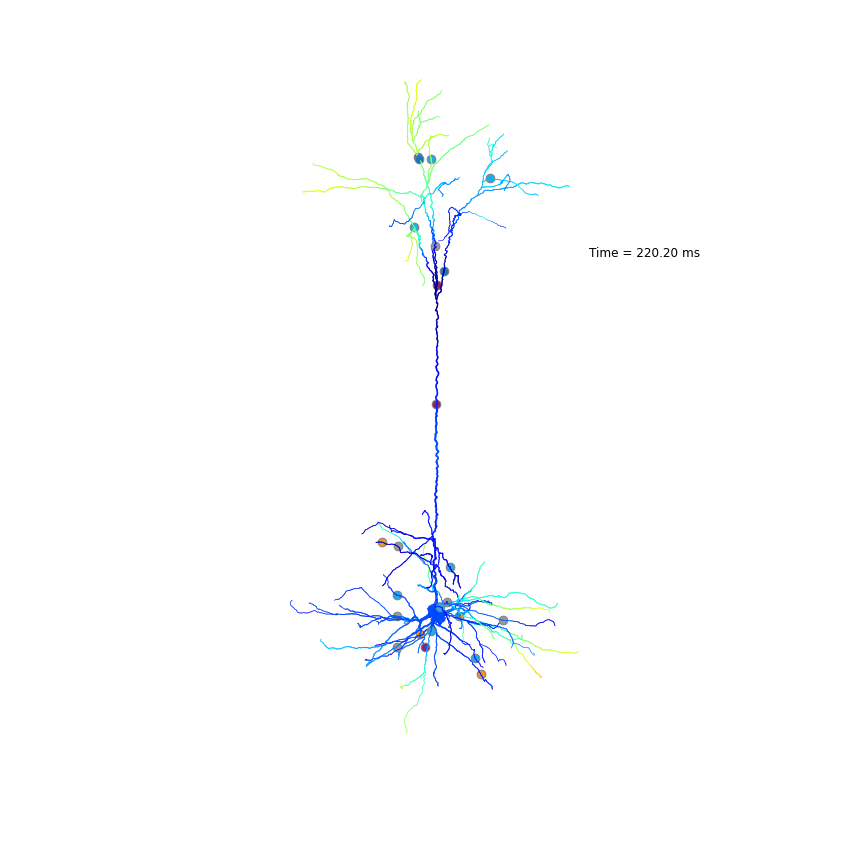
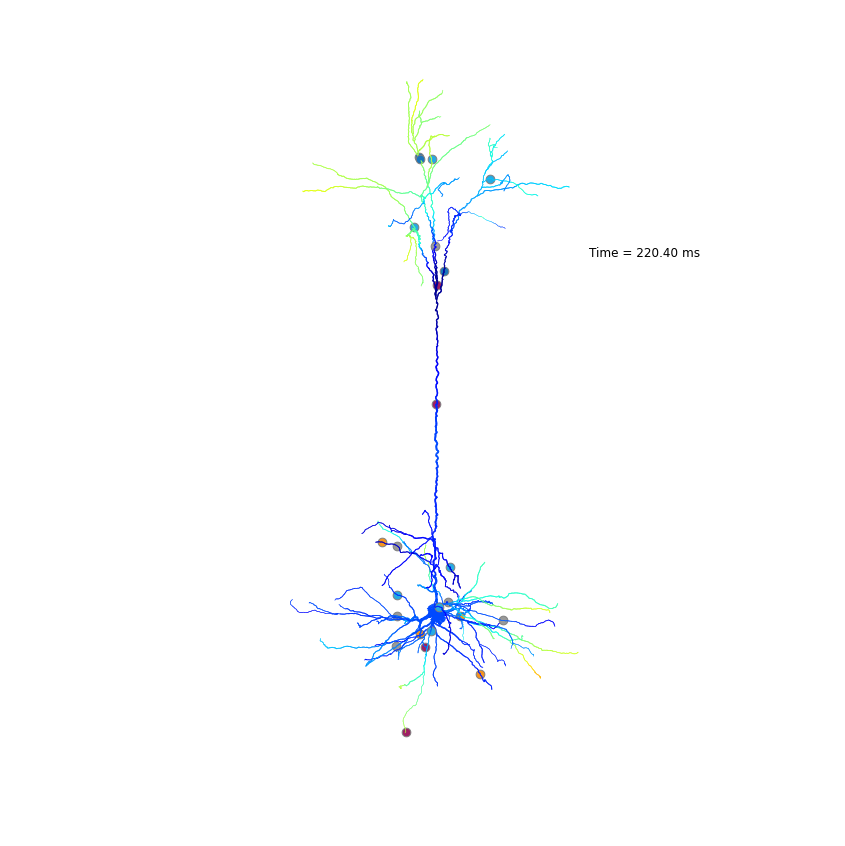
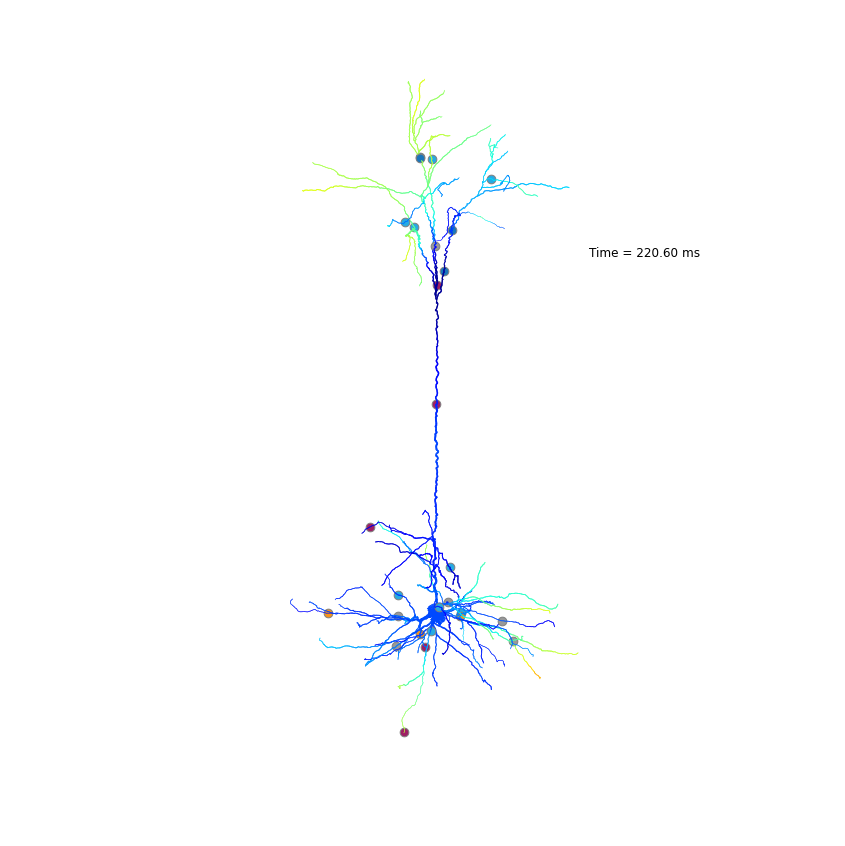
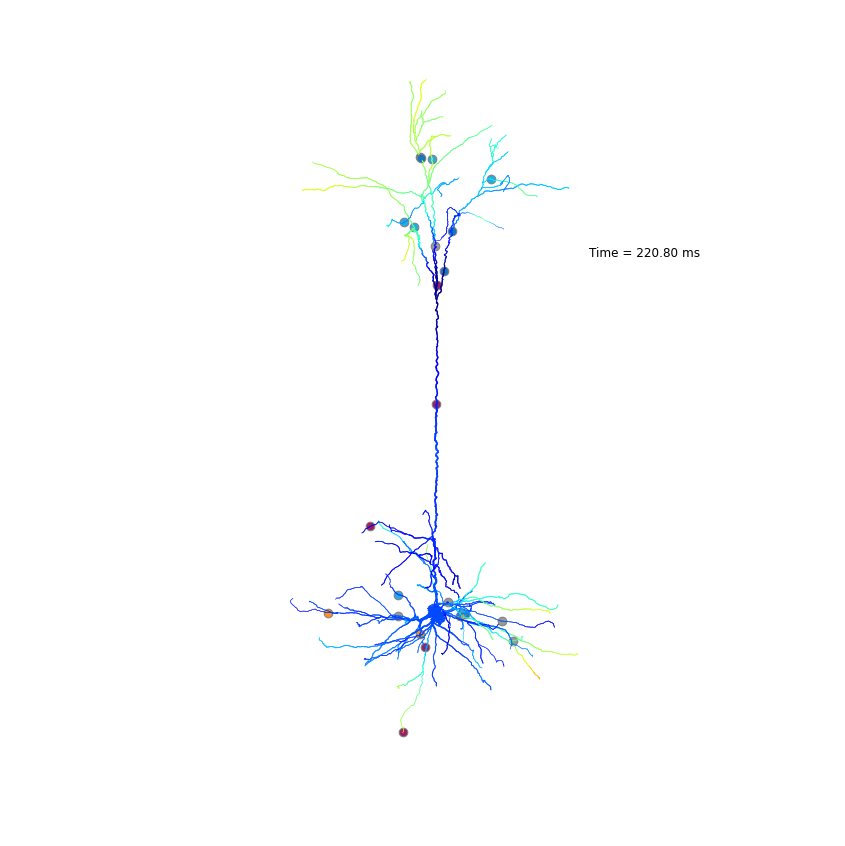
...
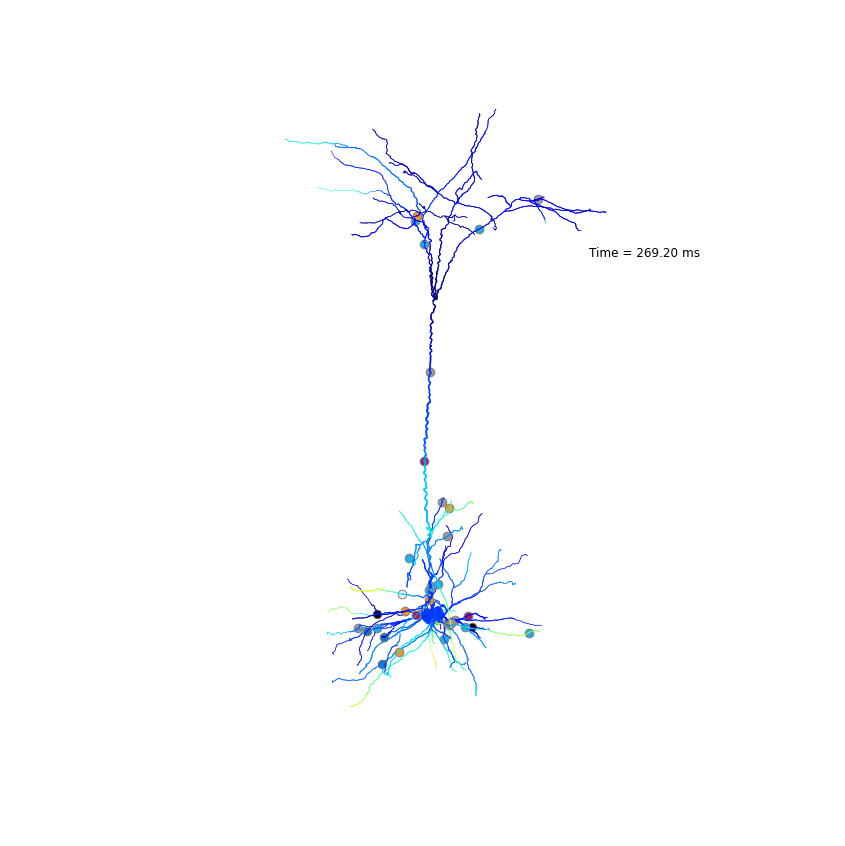
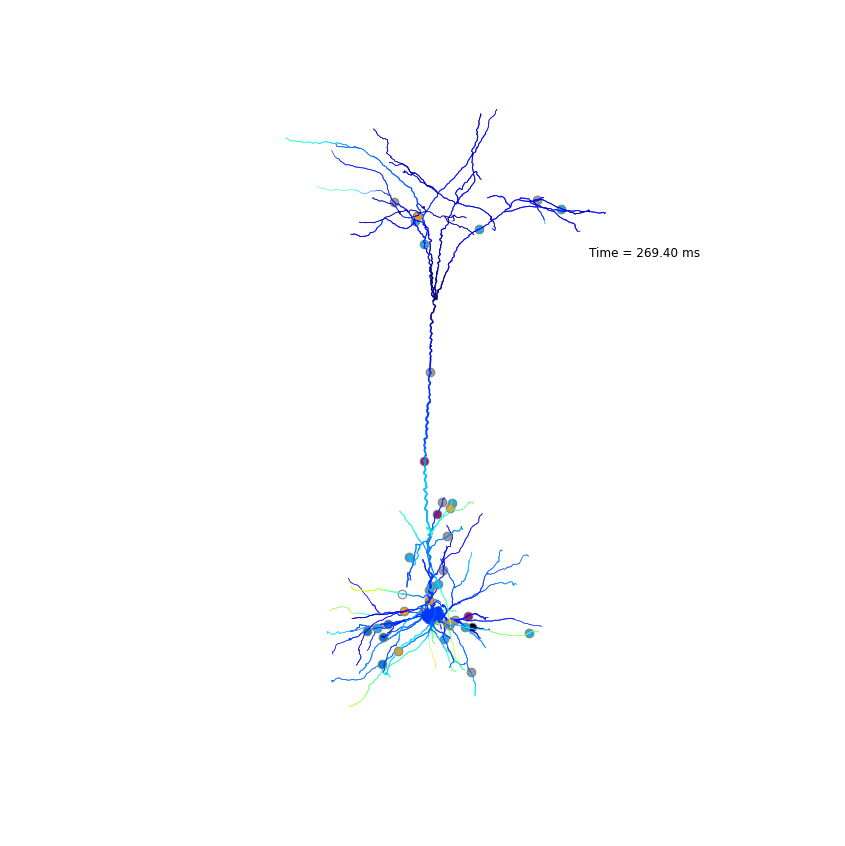
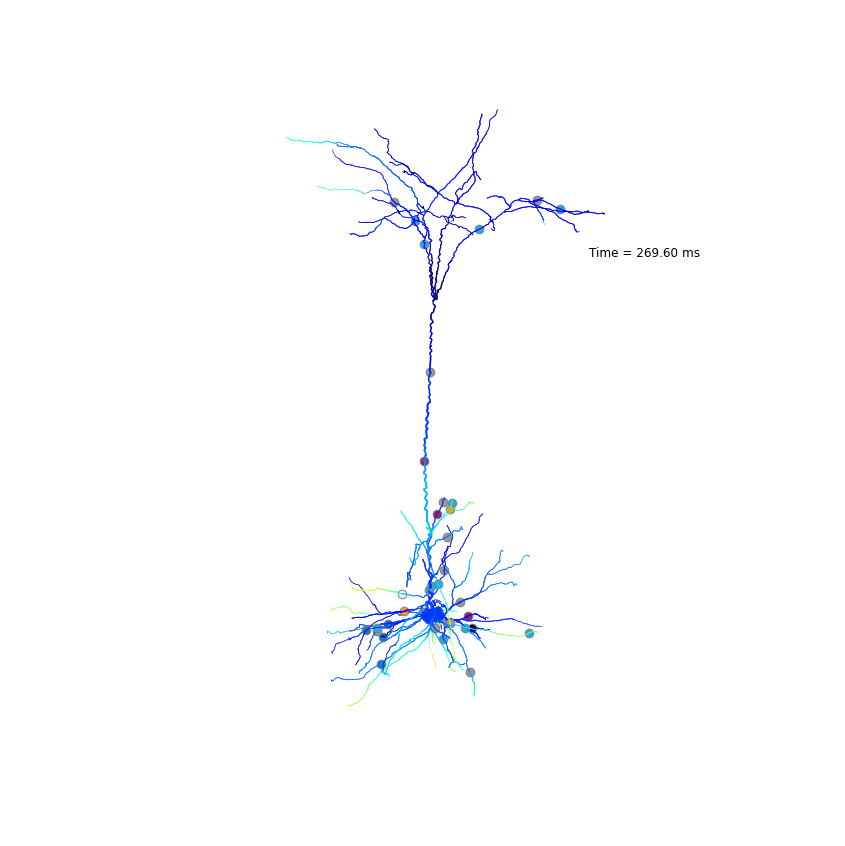
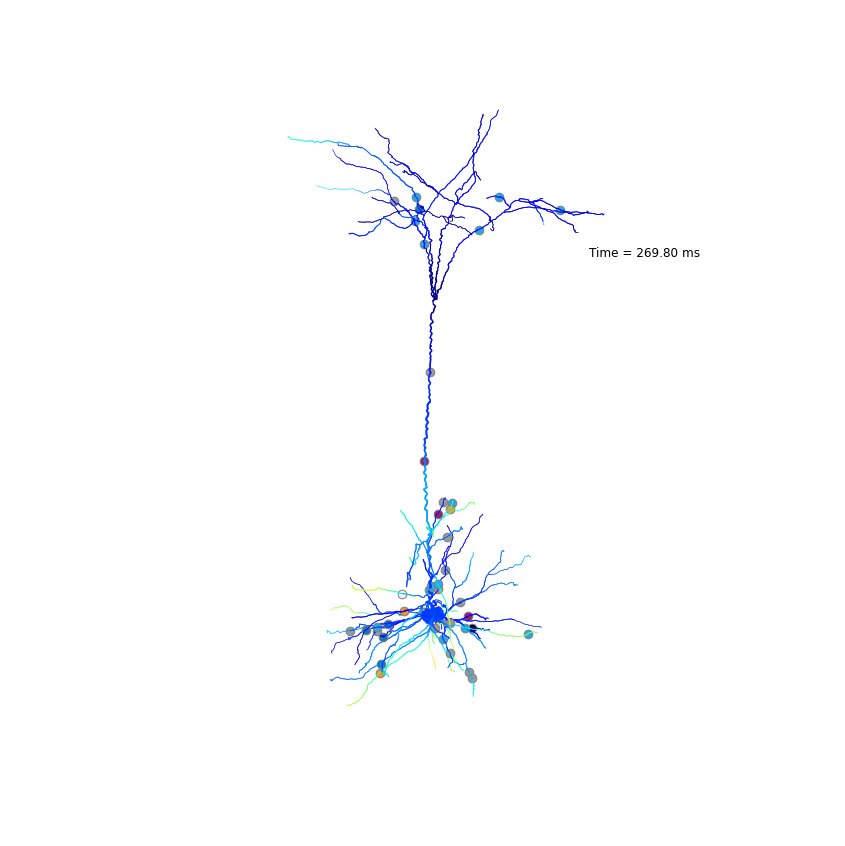
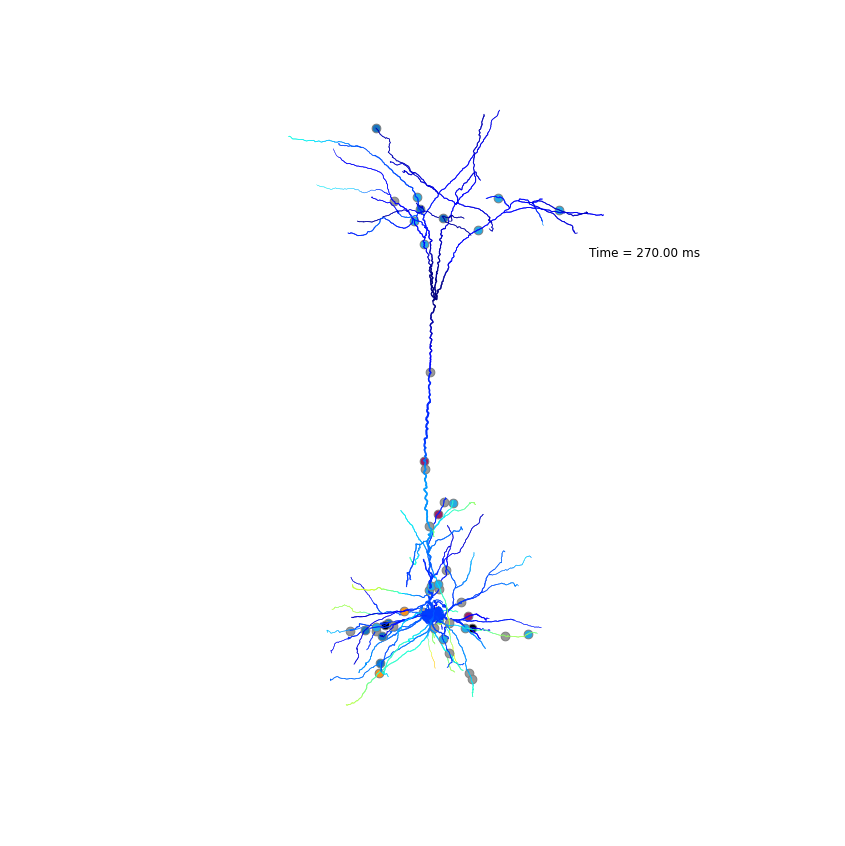

In [20]:
from visualize.cell_morphology_visualizer import CellMorphologyVisualizer

# # To remake the visualization, uncomment this code
# if I.os.path.exists(db._basedir/'D3_stim_animation_3d'):
#     I.shutil.rmtree(db._basedir/'D3_stim_animation_3d')

cmv = CellMorphologyVisualizer(cell)
cmv.population_to_color_dict['inactive'] = "#f0f0f0"  # add color for inactive

images_path = str(db._basedir/'D3_stim_animation_3d')
cmv.animation(
    images_path=images_path, 
    color="voltage",
    show_synapses=True,
    client=I.get_client(), 
    t_start=245-25, t_stop=245+25, t_step=0.2)

You can even visualize the soma locations of the active presynaptic cells. 

As this requires 3D rendering, we are going to step out of python to visualize this. You can write out the postsynaptic cell and presynaptic locations as `.vtk` files: free, open-source and standardized. These can in principle be visualized in Python, but the rendering setup is a bit tedious. You can also use any rendering program that supports `.vtk`. We recommend Paraview.

In [ ]:
if not 'synapse_activation_vtk' in db.keys():
    db.create_managed_folder('synapse_activation_vtk')
db.ls()

Located at /gpfs/soma_fs/home/meulemeester/labs/getting_started_db
getting_started_db
├── cell_activation
├── voltage_traces
├── simresult_path
├── metadata
├── sim_trail_index
├── anatomical_constraints
├── parameterfiles
├── synapse_activation_vtk
├── filelist
├── spike_times
├── D3_stim_animation
├── simrun
├── dendritic_spike_times
│   └── apical_proximal_distal_rec_sites_ID_000_sec_038_seg_032_x_0.929_somaDist_920.7_-30.0
├── dendritic_recordings
│   └── apical_proximal_distal_rec_sites_ID_000_sec_038_seg_032_x_0.929_somaDist_920.7
├── synapse_activation
├── parameterfiles_network_folder
├── biophysical_constraints
├── D3_stim_animation_3d
├── network_param
└── parameterfiles_cell_folder


Let's map the presynaptic cells to their corresponding location. The activation of presynaptic cells, including their celltype, is given in the DataBase key "cell_acativation". Their locations are saved in the "anatomical_constraints" key.

In [50]:
from simrun.utils import get_fraction_of_landmarkAscii_dir
soma_location_pdf = get_fraction_of_landmarkAscii_dir(1, db._basedir/'anatomical_constraints'/'presynaptic_somata')
soma_location_pdf

,positions,label
0,"(-316.2502, 889.3781, 572.244)",presynaptic_somata_L1
1,"(54.38733, 879.5135, 553.1131)",presynaptic_somata_L1
2,"(-154.7015, 164.9819, 655.8002)",presynaptic_somata_L1
3,"(-275.0075, 604.9666, 638.5352)",presynaptic_somata_L1
4,"(-38.03819, 601.873, 582.2783)",presynaptic_somata_L1
...,...,...
19699,"(2326.26, -1328.26, 109.839)",presynaptic_somata_VPM
19700,"(2382.83, -1403.59, 185.072)",presynaptic_somata_VPM
19701,"(2516.96, -1246.36, 215.097)",presynaptic_somata_VPM
19702,"(2405.93, -1378.56, 164.065)",presynaptic_somata_VPM


In [51]:
ca = db['cell_activation'].loc[some_index].compute()
ca['celltype'] = [e.split("_")[0] for e in ca['presynaptic_cell_type']]
ca['celltype'].unique()

load dask dataframe with known divisions


array(['L1', 'L23Trans', 'L2', 'L34', 'L45Peak', 'L45Sym', 'L4py', 'L4sp',
       'L4ss', 'L56Trans', 'L5st', 'L5tt', 'L6cc', 'L6ccinv', 'L6ct',
       'SymLocal1', 'SymLocal2', 'SymLocal3', 'SymLocal4', 'SymLocal5',
       'SymLocal6', 'VPM'], dtype=object)

In [52]:
soma_location_pdf['celltype'] = [e.split("_")[-1] for e in soma_location_pdf['label']]
soma_location_pdf['celltype'].unique()

array(['L1', 'L2', 'L23Trans', 'L34', 'L45Peak', 'L45Sym', 'L4py', 'L4sp',
       'L4ss', 'L56Trans', 'L5st', 'L5tt', 'L6cc', 'L6ccinv', 'L6ct',
       'SymLocal1', 'SymLocal2', 'SymLocal3', 'SymLocal4', 'SymLocal5',
       'SymLocal6', 'VPM'], dtype=object)

In [53]:
cmv.morphology[cmv.morphology['sec_n'] == 10]

,x,y,z,diameter,sec_n,seg_n
1181,6.678971,24.573072,30.641284,0.79,10,0
1182,7.582819,25.558855,30.279949,0.45,10,0
1183,8.068053,26.633651,29.963281,0.45,10,0
1184,8.064054,28.194295,29.612856,0.45,10,0
1185,7.834759,28.757823,29.521749,0.45,10,0
...,...,...,...,...,...,...
1436,23.513724,217.306437,-7.252374,0.45,10,18
1437,23.611422,217.522417,-7.806741,0.45,10,18
1438,23.774646,217.673219,-7.866492,0.45,10,18
1439,24.542341,218.298443,-9.449022,0.45,10,18


In [59]:
from importlib import reload
import visualize.cell_morphology_visualizer
reload(visualize.cell_morphology_visualizer)

from visualize.cell_morphology_visualizer import CellMorphologyVisualizer
outdir = I.os.path.join(db.basedir, 'synapse_activation_vtk')
cmv_unaligned = CellMorphologyVisualizer(cell, align_trunk=False)
cmv_unaligned.write_vtk_frames(
    I.os.path.join(outdir, 'cell_D3_stim.vtk'),
    t_start=245-25, t_stop=245+25,
    t_step=0.2,
    color="voltage",
    client=I.get_client()
    )

In [61]:
from visualize.vtk import save_cells_landmark_files_vtk

outdir = db._basedir/'synapse_activation_vtk'
I.logger.setLevel("INFO")  # some more output
a = save_cells_landmark_files_vtk(
    ca,
    soma_location_pdf,
    times_to_show=cmv_unaligned.times_to_show,  # be sure the times are aligned
    outdir=outdir,
    tspan=5,  # amount of time the synapse stays visible after it has been activated
    set_index = ['celltype', 'cell_ID'])

[INFO] vtk: Celltype nr mapper: {'L1': 0, 'L23Trans': 1, 'L2': 2, 'L34': 3, 'L45Peak': 4, 'L45Sym': 5, 'L4py': 6, 'L4sp': 7, 'L4ss': 8, 'L56Trans': 9, 'L5st': 10, 'L5tt': 11, 'L6cc': 12, 'L6ccinv': 13, 'L6ct': 14, 'SymLocal1': 15, 'SymLocal2': 16, 'SymLocal3': 17, 'SymLocal4': 18, 'SymLocal5': 19, 'SymLocal6': 20, 'VPM': 21}
[WARNING] vtk: No celltypes passed. Using all celltypes in the dataset.


You can now inspect these files in a `.vtk` compatible program. The result should look like this:

In [62]:
from IPython.display import HTML

HTML("""
<center>
    <video alt="video" width="720" controls>
        <source src="../../../docs/_static/synapses.mp4" type="video/mp4" >
    </video>
</center>
""")

### Beyond toy data: 18000 trials

In [67]:
db18k = I.DataBase(I.os.path.join(getting_started_dir, 'example_data', 'simulation_data', '18k_trials'))

[INFO] isf_data_base: Updating metadata for key spike_times


(240.0, 280.0)

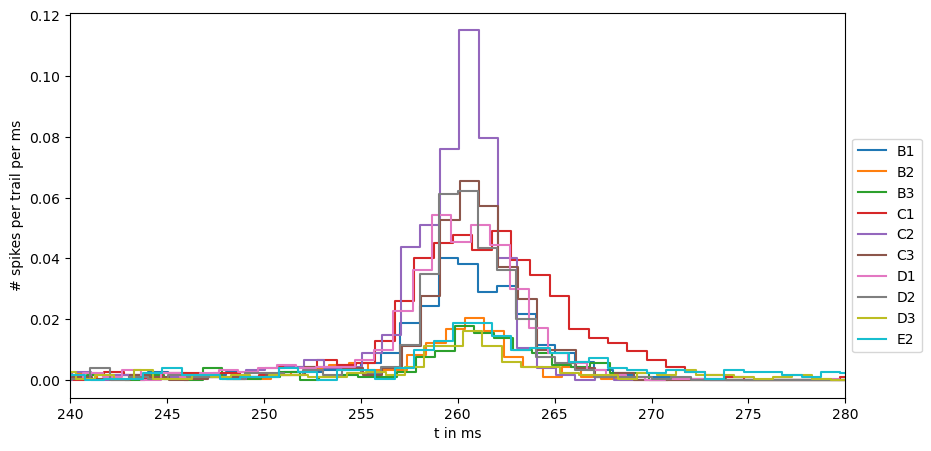

In [110]:
%matplotlib inline
I.plt.style.use("default")
colors = I.plt.rcParams['axes.prop_cycle'].by_key()['color']

st = db18k['spike_times']
st['stim'] = st.index.str.split('_').str[0]
st.reset_index(inplace=True)
st.drop('sim_trail_index', axis=1, inplace=True)
st.fillna(I.np.nan, inplace=True)

fig, ax = I.plt.subplots(figsize = (10,5))
bins = st.groupby('stim').apply(I.temporal_binning)

for i, v in bins.iteritems():
    I.histogram(v, ax=ax, label = i, lw=5)
fig.axes[-1].set_xlabel('t in ms')
fig.axes[-1].set_ylabel('# spikes per trail per ms')
fig.axes[-1].legend(bbox_to_anchor=(1, .1))
fig.axes[-1].set_xlim([240, 280])
